In [3]:
import datetime as dt
import pandas as pd
import matplotlib.pyplot as plt
import tetrion.plots as plots
import tetrion.db
import tetrion.commands as cmd
import tetrion.options
import tetrion.clientcore
import seaborn as sns
from collections import defaultdict
import numpy as np
import warnings
import matplotlib.pyplot as plt
warnings.simplefilter("ignore")
%matplotlib inline 
symbol = pd.read_csv('/local/dist/tetrion/conf/conf/symbol.table', skiprows= 1, header = 2,  delim_whitespace=True)
pd.set_option('display.max_rows', 100)
import datetime as dt

In [4]:
df = pd.read_pickle('../data/vix_1min_2025.pkl')


In [5]:
df = df.sort_values("time").reset_index(drop=True)


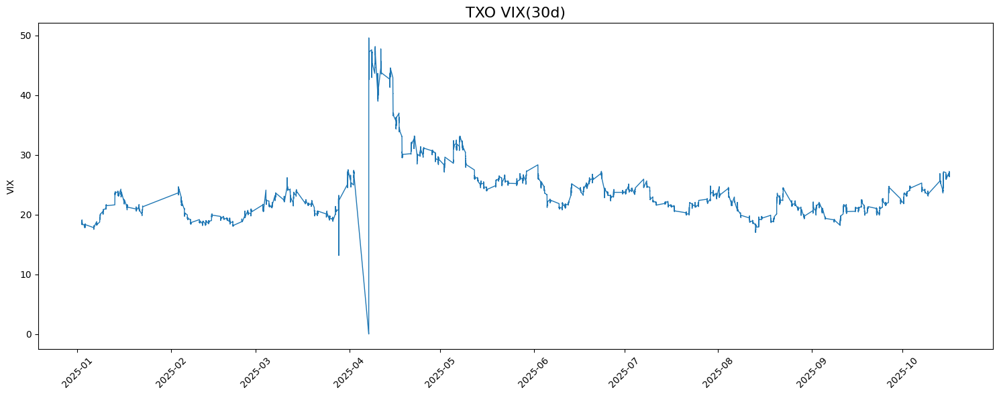

In [6]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from matplotlib.ticker import NullLocator   

fig, ax = plt.subplots(figsize=(15, 6))

ax.plot(df["time"], df["vix_like"], lw=1)

ax.set_title("TXO VIX(30d)", fontsize=16)
ax.set_ylabel("VIX")

ax.xaxis.set_major_locator(mdates.MonthLocator())
ax.xaxis.set_major_formatter(mdates.DateFormatter("%Y-%m"))

ax.xaxis.set_minor_locator(NullLocator())

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [7]:
df

,time,vix_like
0,2025-01-02 08:45:00,18.475369
1,2025-01-02 08:46:00,18.423384
2,2025-01-02 08:47:00,18.465699
3,2025-01-02 08:48:00,18.465165
4,2025-01-02 08:49:00,18.559432
...,...,...
56264,2025-10-16 13:41:00,26.446414
56265,2025-10-16 13:42:00,26.486857
56266,2025-10-16 13:43:00,26.602849
56267,2025-10-16 13:44:00,26.598702


In [8]:
df2 = pd.read_pickle('../data/TXF_H2.pkl')

In [9]:
df2

,mkt_mid,contract
time,,
2025-05-02 09:00:00,20540.0,FUT_TAIFEX_TXF:202505
2025-05-02 09:01:00,20517.5,FUT_TAIFEX_TXF:202505
2025-05-02 09:02:00,20503.0,FUT_TAIFEX_TXF:202505
2025-05-02 09:03:00,20517.0,FUT_TAIFEX_TXF:202505
2025-05-02 09:04:00,20511.5,FUT_TAIFEX_TXF:202505
...,...,...
2025-09-19 13:40:00,25697.0,FUT_TAIFEX_TXF:202510
2025-09-19 13:41:00,25687.5,FUT_TAIFEX_TXF:202510
2025-09-19 13:42:00,25684.0,FUT_TAIFEX_TXF:202510


In [10]:

import plotly.express as px

df2_reset = df2.reset_index()

fig = px.line(df2_reset, x='time', y='mkt_mid', title='TXF H2 mkt_mid Trend')
fig.show()


In [11]:

import plotly.graph_objects as go

fig = go.Figure()

# Add VIX trace
fig.add_trace(go.Scatter(x=df['time'], y=df['vix_like'], mode='lines', name='VIX', yaxis='y1'))

# Add TXF mkt_mid trace with secondary y-axis
df2_reset = df2.reset_index()
fig.add_trace(go.Scatter(x=df2_reset['time'], y=df2_reset['mkt_mid'], mode='lines', name='TXF mkt_mid', yaxis='y2'))

# Update layout for dual y-axes
fig.update_layout(
    title='VIX vs TXF mkt_mid Comparison',
    xaxis=dict(title='Time'),
    yaxis=dict(title='VIX'),
    yaxis2=dict(title='mkt_mid', overlaying='y', side='right')
)

fig.show()


In [44]:
def run_gamma_scalping(price_df, gamma=10, threshold=10, cost_per_trade=0):
    """
    Simple Gamma Scalping Backtest
    """
    # Sort by time
    data = price_df.sort_values('time').reset_index(drop=True)
    
    trades = []
    last_hedge_price = data['mkt_mid'].iloc[0]
    cumulative_pnl = 0
    
    for row in data.itertuples():
        current_price = row.mkt_mid
        current_time = row.time
        
        # ds: price change since last hedge
        ds = current_price - last_hedge_price
        
        # Check threshold
        if abs(ds) >= threshold:
            # Gamma PnL (Gross) = 0.5 * Gamma * ds^2
            gross_pnl = 0.5 * gamma * (ds ** 2)
            
            # Calculate cost
            # Trade volume = Gamma * ds
            trade_vol = abs(gamma * ds)
            cost = trade_vol * cost_per_trade
            
            net_pnl = gross_pnl - cost
            cumulative_pnl += net_pnl
            
            trades.append({
                'time': current_time,
                'price': current_price,
                'last_hedge_price': last_hedge_price,
                'ds': ds,
                'gross_pnl': gross_pnl,
                'cost': cost,
                'net_pnl': net_pnl,
                'cumulative_pnl': cumulative_pnl,
                'vix': getattr(row, 'vix_like', np.nan) # Record VIX if available
            })
            
            # Update last hedge price
            last_hedge_price = current_price
            
    return pd.DataFrame(trades)

# Parameters
GAMMA_CONST = 10
THRESHOLD = 20

# Run backtest (using df2: TXF data)
if 'time' not in df2.columns:
    df2_run = df2.reset_index()
else:
    df2_run = df2.copy()

results_df = run_gamma_scalping(df2_run, gamma=GAMMA_CONST, threshold=THRESHOLD)

# Summary
print(f"Parameter: Gamma={GAMMA_CONST}, Threshold={THRESHOLD}")
print(f"Total Trades: {len(results_df)}")
print(f"Total Gamma PnL: {results_df['cumulative_pnl'].iloc[-1]:,.2f}" if not results_df.empty else "No Trades")

results_df.head(10)

Parameter: Gamma=10, Threshold=20
Total Trades: 2229
Total Gamma PnL: 29,590,488.75


,time,price,last_hedge_price,ds,gross_pnl,cost,net_pnl,cumulative_pnl,vix
0,2025-05-02 09:01:00,20517.5,20540.0,-22.5,2531.25,0.0,2531.25,2531.25,NaN
1,2025-05-02 09:10:00,20544.0,20517.5,26.5,3511.25,0.0,3511.25,6042.50,NaN
2,2025-05-02 09:13:00,20575.0,20544.0,31.0,4805.00,0.0,4805.00,10847.50,NaN
3,2025-05-02 09:17:00,20546.5,20575.0,-28.5,4061.25,0.0,4061.25,14908.75,NaN
4,2025-05-02 09:26:00,20568.5,20546.5,22.0,2420.00,0.0,2420.00,17328.75,NaN
5,2025-05-02 09:28:00,20534.0,20568.5,-34.5,5951.25,0.0,5951.25,23280.00,NaN
6,2025-05-02 09:40:00,20501.5,20534.0,-32.5,5281.25,0.0,5281.25,28561.25,NaN
7,2025-05-02 09:51:00,20523.0,20501.5,21.5,2311.25,0.0,2311.25,30872.50,NaN
8,2025-05-02 09:55:00,20548.0,20523.0,25.0,3125.00,0.0,3125.00,33997.50,NaN
9,2025-05-02 09:59:00,20521.0,20548.0,-27.0,3645.00,0.0,3645.00,37642.50,NaN


In [43]:
results_df

,time,price,last_hedge_price,ds,gross_pnl,cost,net_pnl,cumulative_pnl,vix
0,2025-05-02 09:01:00,20517.5,20540.0,-22.5,2531.25,0.0,2531.25,2531.25,NaN
1,2025-05-02 09:02:00,20503.0,20517.5,-14.5,1051.25,0.0,1051.25,3582.50,NaN
2,2025-05-02 09:03:00,20517.0,20503.0,14.0,980.00,0.0,980.00,4562.50,NaN
3,2025-05-02 09:05:00,20506.0,20517.0,-11.0,605.00,0.0,605.00,5167.50,NaN
4,2025-05-02 09:06:00,20520.5,20506.0,14.5,1051.25,0.0,1051.25,6218.75,NaN
...,...,...,...,...,...,...,...,...,...
5571,2025-09-19 13:31:00,25700.5,25686.5,14.0,980.00,0.0,980.00,29657436.25,NaN
5572,2025-09-19 13:34:00,25690.5,25700.5,-10.0,500.00,0.0,500.00,29657936.25,NaN
5573,2025-09-19 13:39:00,25706.0,25690.5,15.5,1201.25,0.0,1201.25,29659137.50,NaN
5574,2025-09-19 13:41:00,25687.5,25706.0,-18.5,1711.25,0.0,1711.25,29660848.75,NaN


In [39]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

if not results_df.empty:
    # Create dual-axis plot
    fig = make_subplots(specs=[[{"secondary_y": True}]])

    # 1. TXF Price (Background)
    fig.add_trace(
        go.Scatter(x=df2_run['time'], y=df2_run['mkt_mid'], name="TXF Price", line=dict(color='gray', width=1), opacity=0.5),
        secondary_y=False
    )

    # 2. Hedge Points
    fig.add_trace(
        go.Scatter(x=results_df['time'], y=results_df['price'], mode='markers', name="Hedge Points", marker=dict(color='red', size=5)),
        secondary_y=False
    )

    # 3. Cumulative PnL
    fig.add_trace(
        go.Scatter(x=results_df['time'], y=results_df['cumulative_pnl'], name="Cumulative Gamma PnL", line=dict(color='blue', width=2)),
        secondary_y=True
    )

    fig.update_layout(
        title_text=f"Gamma Scalping Backtest (Gamma={GAMMA_CONST}, Threshold={THRESHOLD})",
        hovermode="x unified"
    )

    fig.update_yaxes(title_text="Price", secondary_y=False)
    fig.update_yaxes(title_text="Cumulative PnL", secondary_y=True)

    fig.show()
else:
    print("No trades generated with current threshold.")

In [40]:
# Compare different Thresholds
thresholds = list(range(10, 150, 10))
comparison_results = []

fig = go.Figure()

for th in thresholds:
    # Run backtest
    res = run_gamma_scalping(df2_run, gamma=GAMMA_CONST, threshold=th)
    
    if not res.empty:
        final_pnl = res['cumulative_pnl'].iloc[-1]
        trade_count = len(res)
        
        comparison_results.append({
            'Threshold': th,
            'Total PnL': final_pnl,
            'Trades': trade_count
        })
        
        # Plot PnL curve
        fig.add_trace(go.Scatter(x=res['time'], y=res['cumulative_pnl'], mode='lines', name=f'Th={th} (PnL: {final_pnl:,.0f})'))

# Show comparison chart
fig.update_layout(
    title=f'Gamma Scalping PnL Comparison (Gamma={GAMMA_CONST})',
    xaxis_title='Time',
    yaxis_title='Cumulative PnL',
    hovermode="x unified"
)
fig.show()

# Show stats table
comp_df = pd.DataFrame(comparison_results)
print(comp_df)

# Simple analysis
if not comp_df.empty:
    best_th = comp_df.loc[comp_df['Total PnL'].idxmax()]
    print(f"\nBest Threshold: {best_th['Threshold']} (PnL: {best_th['Total PnL']:,.2f}, Trades: {best_th['Trades']})")

    Threshold    Total PnL  Trades
0          10  29661348.75    5576
1          20  29590488.75    2229
2          30  30021603.75    1245
3          40  29487131.25     790
4          50  29468741.25     545
5          60  29745767.50     397
6          70  29496153.75     328
7          80  29142505.00     263
8          90  29977803.75     212
9         100  29760502.50     201
10        110  30585362.50     173
11        120  30497061.25     151
12        130  29975023.75     130
13        140  30519371.25     124

Best Threshold: 110.0 (PnL: 30,585,362.50, Trades: 173.0)


In [41]:
# Prepare data: Merge TXF and VIX
df_vix = df[['time', 'vix_like']].sort_values('time')
df_txf = df2.reset_index().sort_values('time') if 'time' not in df2.columns else df2.sort_values('time')

# Merge VIX to TXF timestamps (backward)
df_merged = pd.merge_asof(df_txf, df_vix, on='time', direction='backward')

# Remove September data
df_merged = df_merged[df_merged['time'].dt.month != 9]
print(f"Data filtered. Removed September. Remaining rows: {len(df_merged)}")

# Define VIX Regimes (5-point intervals)
vix_bins = [0, 15, 20, 25, 30, 100]
vix_labels = ['<15', '15-20', '20-25', '25-30', '>30']

# Run analysis by VIX regime
thresholds = list(range(10, 150, 10))
analysis_results = []
COST_PER_TRADE = 5 

print("Running analysis by VIX regime...")

for th in thresholds:
    # Run global backtest
    res = run_gamma_scalping(df_merged, gamma=GAMMA_CONST, threshold=th, cost_per_trade=COST_PER_TRADE)
    
    if res.empty:
        continue
        
    # Label VIX Regime
    res['vix_regime'] = pd.cut(res['vix'], bins=vix_bins, labels=vix_labels)
    
    # Stats per regime
    summary = res.groupby('vix_regime')['net_pnl'].sum()
    count = res.groupby('vix_regime')['net_pnl'].count()
    
    for regime in vix_labels:
        if regime in summary.index:
            analysis_results.append({
                'Threshold': th,
                'Regime': regime,
                'Total Net PnL': summary[regime],
                'Trade Count': count[regime],
                'Avg PnL per Trade': summary[regime] / count[regime] if count[regime] > 0 else 0
            })

analysis_df = pd.DataFrame(analysis_results)

# Display results
if not analysis_df.empty:
    from plotly.subplots import make_subplots
    import plotly.graph_objects as go
    import math

    # Calculate rows needed
    n_regimes = len(vix_labels)
    n_cols = 2
    n_rows = math.ceil(n_regimes / n_cols)

    # Create dynamic subplots
    fig = make_subplots(
        rows=n_rows, cols=n_cols,
        subplot_titles=vix_labels,
        vertical_spacing=0.1
    )

    for i, regime in enumerate(vix_labels):
        row = (i // n_cols) + 1
        col = (i % n_cols) + 1
        
        # Filter data for regime
        subset = analysis_df[analysis_df['Regime'] == regime]
        
        if not subset.empty:
            fig.add_trace(
                go.Bar(
                    x=subset['Threshold'],
                    y=subset['Total Net PnL'],
                    name=regime,
                    text=subset['Total Net PnL'].apply(lambda x: f"{x:,.0f}"),
                    textposition='auto'
                ),
                row=row, col=col
            )
            fig.update_xaxes(title_text="Threshold", type='category', row=row, col=col)
            fig.update_yaxes(title_text="Net PnL", row=row, col=col)

    fig.update_layout(
        title_text=f"PnL vs Threshold by VIX Regime (Cost={COST_PER_TRADE})",
        height=300 * n_rows, 
        showlegend=False
    )
    fig.show()
    
    # Find best threshold per regime
    print("\nBest Strategy per Regime:")
    best_strategies = analysis_df.loc[analysis_df.groupby("Regime")["Total Net PnL"].idxmax()]
    print(best_strategies[['Regime', 'Threshold', 'Total Net PnL', 'Trade Count']])
else:
    print("No trades generated.")

Data filtered. Removed September. Remaining rows: 24167
Running analysis by VIX regime...



Best Strategy per Regime:
   Regime  Threshold  Total Net PnL  Trade Count
26  15-20         60     1150175.00           39
52  20-25        110    13446637.50           98
58  25-30        120     7696980.00           39
0     <15         10           0.00            0
64    >30        130     1089188.75           11


In [42]:
# Analyze Cumulative PnL Curve Smoothness by VIX Regime
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import math

# Parameters (5-point intervals)
vix_bins = [0, 15, 20, 25, 30, 100]
vix_labels = ['<15', '15-20', '20-25', '25-30', '>30']
thresholds = list(range(10, 150, 10))
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']

# Calculate rows needed
n_regimes = len(vix_labels)
n_cols = 2
n_rows = math.ceil(n_regimes / n_cols)

fig = make_subplots(
    rows=n_rows, cols=n_cols, 
    subplot_titles=vix_labels,
    vertical_spacing=0.1,
    horizontal_spacing=0.1
)

print("Generating cumulative PnL curves by regime...")

for t_idx, th in enumerate(thresholds):
    # 1. Run backtest
    res = run_gamma_scalping(df_merged, gamma=GAMMA_CONST, threshold=th, cost_per_trade=COST_PER_TRADE)
    
    if res.empty: continue
        
    # 2. Label VIX Regime
    res['vix_regime'] = pd.cut(res['vix'], bins=vix_bins, labels=vix_labels)
    
    # 3. Plot cumulative PnL for each regime
    for i, regime in enumerate(vix_labels):
        # Filter trades for regime
        regime_data = res[res['vix_regime'] == regime].copy()
        
        if not regime_data.empty:
            # Calculate cumulative PnL for this regime only
            regime_data['regime_cum_pnl'] = regime_data['net_pnl'].cumsum()
            
            row = (i // n_cols) + 1
            col = (i % n_cols) + 1
            
            fig.add_trace(
                go.Scatter(
                    x=regime_data['time'], 
                    y=regime_data['regime_cum_pnl'],
                    mode='lines',
                    name=f'Th={th}',
                    line=dict(color=colors[t_idx % len(colors)], width=1.5),
                    legendgroup=f'Th={th}',
                    showlegend=(i==0) # Show legend only on first plot
                ),
                row=row, col=col
            )

fig.update_layout(
    title=f'Cumulative PnL Curves by VIX Regime (Cost={COST_PER_TRADE})',
    height=300 * n_rows,
    hovermode="x unified"
)

fig.show()

Generating cumulative PnL curves by regime...


# Revised Cost Calculation: TXF Hedging
In practice, hedging is done using TXF futures.
*   **Gamma**: 10
*   **Price Move (ds)**: Multiples of 20 (e.g., 20, 40...)
*   **Delta Change**: $Gamma \times ds$
    *   Example: $10 \times 20 = 200$ Delta
*   **Hedging Instrument**: TXF (Big TX)
    *   1 Contract = 200 Delta (200 TWD/point)
*   **Contracts Traded**: Round($\frac{\text{Delta Change}}{200}$) to nearest integer
*   **Cost**: Contracts $\times$ 10 TWD

In [53]:
def run_gamma_scalping_txf_cost(price_df, gamma=10, threshold=20, cost_per_contract=10):
    """
    Gamma Scalping with TXF Hedging Cost Logic
    
    Logic:
    1. Delta Change = Gamma * ds
    2. Contracts = Round(Delta Change / 200) -> Integer
    3. Cost = Contracts * cost_per_contract
    4. Tracks cum_delta (accumulated unhedged delta)
    """
    data = price_df.sort_values('time').reset_index(drop=True)
    
    trades = []
    last_hedge_price = data['mkt_mid'].iloc[0]
    cumulative_pnl = 0
    cum_delta = 0 # Accumulated unhedged delta
    
    # Constant for TXF Delta (1 point = 200 TWD)
    TXF_DELTA_PER_CONTRACT = 200
    
    for row in data.itertuples():
        current_price = row.mkt_mid
        current_time = row.time
        
        ds = current_price - last_hedge_price
        
        if abs(ds) >= threshold:
            # Gross PnL
            gross_pnl = 0.5 * gamma * (ds ** 2)
            
            # Calculate Delta Change (Signed)
            delta_change_step = gamma * ds
            
            # Calculate Contracts needed to hedge (Magnitude)
            # We hedge the step change
            num_contracts = int(round(abs(delta_change_step) / TXF_DELTA_PER_CONTRACT))
            
            # Calculate Hedge Delta (Signed)
            # If ds > 0 (Price Up), Delta increases, we need to Sell (Negative Delta)
            # If ds < 0 (Price Down), Delta decreases, we need to Buy (Positive Delta)
            hedge_delta = -1 * np.sign(ds) * num_contracts * TXF_DELTA_PER_CONTRACT
            
            # Update Cumulative Delta (Residual)
            step_residual = delta_change_step + hedge_delta
            cum_delta += step_residual
            
            # Calculate Cost
            cost = num_contracts * cost_per_contract
            
            net_pnl = gross_pnl - cost
            cumulative_pnl += net_pnl
            
            trades.append({
                'time': current_time,
                'price': current_price,
                'ds': ds,
                'delta_change': delta_change_step,
                'num_contracts': num_contracts,
                'hedge_delta': hedge_delta,
                'cum_delta': cum_delta,
                'gross_pnl': gross_pnl,
                'cost': cost,
                'net_pnl': net_pnl,
                'cumulative_pnl': cumulative_pnl,
                'vix': getattr(row, 'vix_like', np.nan)
            })
            
            last_hedge_price = current_price
            
    return pd.DataFrame(trades)

In [54]:
# Test the new logic
# Parameters: Gamma=10, Threshold=20 (matches 1 contract exactly), Cost=10 per contract
GAMMA_TEST = 10
THRESHOLD_TEST = 20
COST_PER_TXF = 10

res_txf = run_gamma_scalping_txf_cost(
    df_merged, 
    gamma=GAMMA_TEST, 
    threshold=THRESHOLD_TEST, 
    cost_per_contract=COST_PER_TXF
)

print(f"Total Trades: {len(res_txf)}")
print(f"Total Net PnL: {res_txf['cumulative_pnl'].iloc[-1]:,.2f}" if not res_txf.empty else "No Trades")

if not res_txf.empty:
    # Show details to verify cost calculation and cum_delta
    print("\nSample Trades:")
    display(res_txf[['time', 'price', 'ds', 'delta_change', 'num_contracts', 'hedge_delta', 'cum_delta', 'cost', 'net_pnl']].head(10))
    
    # Check final cum_delta
    print(f"\nFinal Cumulative Delta: {res_txf['cum_delta'].iloc[-1]:.2f}")
    
    # Plot Cum Delta
    import plotly.express as px
    fig = px.line(res_txf, x='time', y='cum_delta', title='Accumulated Unhedged Delta Over Time')
    fig.show()

Total Trades: 2181
Total Net PnL: 22,063,172.50

Sample Trades:


,time,price,ds,delta_change,num_contracts,hedge_delta,cum_delta,cost,net_pnl
0,2025-05-02 09:01:00,20517.5,-22.5,-225.0,1,200.0,-25.0,10,2521.25
1,2025-05-02 09:10:00,20544.0,26.5,265.0,1,-200.0,40.0,10,3501.25
2,2025-05-02 09:13:00,20575.0,31.0,310.0,2,-400.0,-50.0,20,4785.00
3,2025-05-02 09:17:00,20546.5,-28.5,-285.0,1,200.0,-135.0,10,4051.25
4,2025-05-02 09:26:00,20568.5,22.0,220.0,1,-200.0,-115.0,10,2410.00
5,2025-05-02 09:28:00,20534.0,-34.5,-345.0,2,400.0,-60.0,20,5931.25
6,2025-05-02 09:40:00,20501.5,-32.5,-325.0,2,400.0,15.0,20,5261.25
7,2025-05-02 09:51:00,20523.0,21.5,215.0,1,-200.0,30.0,10,2301.25
8,2025-05-02 09:55:00,20548.0,25.0,250.0,1,-200.0,80.0,10,3115.00
9,2025-05-02 09:59:00,20521.0,-27.0,-270.0,1,200.0,10.0,10,3635.00



Final Cumulative Delta: -360.00


In [55]:
# Analysis with TXF Cost Logic: PnL by VIX Regime
# Thresholds: Multiples of 20 (20, 40, 60...)
thresholds = list(range(20, 150, 20))
COST_PER_CONTRACT = 10
GAMMA_CONST = 10

# VIX Regimes
vix_bins = [0, 15, 20, 25, 30, 100]
vix_labels = ['<15', '15-20', '20-25', '25-30', '>30']

analysis_results = []

print("Running TXF Cost analysis by VIX regime...")

for th in thresholds:
    # Run backtest with new cost logic
    res = run_gamma_scalping_txf_cost(df_merged, gamma=GAMMA_CONST, threshold=th, cost_per_contract=COST_PER_CONTRACT)
    
    if res.empty: continue
        
    # Label VIX Regime
    res['vix_regime'] = pd.cut(res['vix'], bins=vix_bins, labels=vix_labels)
    
    # Stats per regime
    summary = res.groupby('vix_regime')['net_pnl'].sum()
    count = res.groupby('vix_regime')['net_pnl'].count()
    
    for regime in vix_labels:
        if regime in summary.index:
            analysis_results.append({
                'Threshold': th,
                'Regime': regime,
                'Total Net PnL': summary[regime],
                'Trade Count': count[regime]
            })

analysis_df = pd.DataFrame(analysis_results)

# Plot Bar Charts
if not analysis_df.empty:
    from plotly.subplots import make_subplots
    import plotly.graph_objects as go
    import math

    n_regimes = len(vix_labels)
    n_cols = 2
    n_rows = math.ceil(n_regimes / n_cols)

    fig = make_subplots(
        rows=n_rows, cols=n_cols,
        subplot_titles=vix_labels,
        vertical_spacing=0.1
    )

    for i, regime in enumerate(vix_labels):
        row = (i // n_cols) + 1
        col = (i % n_cols) + 1
        
        subset = analysis_df[analysis_df['Regime'] == regime]
        
        if not subset.empty:
            fig.add_trace(
                go.Bar(
                    x=subset['Threshold'],
                    y=subset['Total Net PnL'],
                    name=regime,
                    text=subset['Total Net PnL'].apply(lambda x: f"{x:,.0f}"),
                    textposition='auto'
                ),
                row=row, col=col
            )
            fig.update_xaxes(title_text="Threshold", type='category', row=row, col=col)
            fig.update_yaxes(title_text="Net PnL", row=row, col=col)

    fig.update_layout(
        title_text=f"PnL vs Threshold (TXF Cost Logic, Cost={COST_PER_CONTRACT})",
        height=300 * n_rows, 
        showlegend=False
    )
    fig.show()
    
    print("\nBest Strategy per Regime (TXF Cost):")
    best_strategies = analysis_df.loc[analysis_df.groupby("Regime")["Total Net PnL"].idxmax()]
    print(best_strategies)
else:
    print("No trades generated.")

Running TXF Cost analysis by VIX regime...



Best Strategy per Regime (TXF Cost):
    Threshold Regime  Total Net PnL  Trade Count
6          40  15-20     1318773.75           73
27        120  20-25    13736296.25           88
28        120  25-30     8037270.00           39
0          20    <15           0.00            0
19         80    >30     1173297.50           21


In [56]:
# Analysis with TXF Cost Logic: Cumulative PnL Curves
fig = make_subplots(
    rows=n_rows, cols=n_cols, 
    subplot_titles=vix_labels,
    vertical_spacing=0.1,
    horizontal_spacing=0.1
)

print("Generating cumulative PnL curves (TXF Cost)...")

colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']

for t_idx, th in enumerate(thresholds):
    # Run backtest
    res = run_gamma_scalping_txf_cost(df_merged, gamma=GAMMA_CONST, threshold=th, cost_per_contract=COST_PER_CONTRACT)
    
    if res.empty: continue
        
    res['vix_regime'] = pd.cut(res['vix'], bins=vix_bins, labels=vix_labels)
    
    for i, regime in enumerate(vix_labels):
        regime_data = res[res['vix_regime'] == regime].copy()
        
        if not regime_data.empty:
            regime_data['regime_cum_pnl'] = regime_data['net_pnl'].cumsum()
            
            row = (i // n_cols) + 1
            col = (i % n_cols) + 1
            
            fig.add_trace(
                go.Scatter(
                    x=regime_data['time'], 
                    y=regime_data['regime_cum_pnl'],
                    mode='lines',
                    name=f'Th={th}',
                    line=dict(color=colors[t_idx % len(colors)], width=1.5),
                    legendgroup=f'Th={th}',
                    showlegend=(i==0)
                ),
                row=row, col=col
            )

fig.update_layout(
    title=f'Cumulative PnL Curves by VIX Regime (TXF Cost Logic)',
    height=300 * n_rows,
    hovermode="x unified"
)

fig.show()

Generating cumulative PnL curves (TXF Cost)...


In [80]:
def run_gamma_scalping_cum_delta(price_df, gamma=10, cost_per_contract=10):
    """
    Gamma Scalping with Cumulative Delta Logic & Real PnL Tracking
    
    Logic:
    1. Track Net Delta (cum_delta) continuously.
    2. Hedge with Futures when Net Delta >= 200.
    3. PnL Calculation:
       - Option PnL: Theoretical Long Gamma Value (0.5 * Gamma * (Price - Start)^2)
       - Futures PnL: Mark-to-Market (Position * Price_Change * 200)
       - Total PnL: Option PnL + Futures PnL - Costs
    """
    data = price_df.sort_values('time').reset_index(drop=True)
    data['price_change'] = data['mkt_mid'].diff().fillna(0)
    
    trades = []
    
    # State
    cum_delta = 0 # Net Delta (Option + Futures)
    fut_pos = 0   # Futures Contracts held
    
    # PnL Accumulators
    fut_pnl_cum = 0
    total_cost = 0
    
    start_price = data['mkt_mid'].iloc[0]
    TXF_POINT_VALUE = 200
    
    for row in data.itertuples():
        # 1. Update Futures PnL (MtM)
        # PnL from holding futures over this price change
        fut_pnl_change = fut_pos * row.price_change * TXF_POINT_VALUE
        fut_pnl_cum += fut_pnl_change
        
        # 2. Update Net Delta (cum_delta)
        # Add new Option Delta generated by price move
        delta_change = gamma * row.price_change
        cum_delta += delta_change
        
        # 3. Check Threshold
        trade_contracts = 0
        if abs(cum_delta) >= TXF_POINT_VALUE:
            # Need to hedge
            # If cum_delta is +200, we need to reduce it by 200.
            # We do this by Selling 1 Future (Delta -200).
            # num_contracts to trade (magnitude)
            num_contracts = int(cum_delta / TXF_POINT_VALUE) 
            
            if num_contracts != 0:
                # Trade
                # If num_contracts is positive (e.g. 1), it means we have excess positive delta.
                # We need to SELL futures.
                # fut_pos change should be -num_contracts
                trade_contracts = -num_contracts
                fut_pos += trade_contracts
                
                # Cost
                trade_cost = abs(trade_contracts) * cost_per_contract
                total_cost += trade_cost
                
                # Update Net Delta (cum_delta)
                # We added (trade_contracts * 200) delta to our portfolio
                hedged_delta = trade_contracts * TXF_POINT_VALUE
                cum_delta += hedged_delta 
                
        # 4. Calculate Total PnL
        # Option PnL (Theoretical Long Gamma)
        opt_pnl = 0.5 * gamma * ((row.mkt_mid - start_price) ** 2)
        
        total_pnl = opt_pnl + fut_pnl_cum - total_cost
        
        trades.append({
            'time': row.time,
            'price': row.mkt_mid,
            'net_delta': cum_delta,
            'fut_pos': fut_pos,
            'opt_pnl': opt_pnl,
            'fut_pnl': fut_pnl_cum,
            'total_pnl': total_pnl,
            'cost': total_cost,
            'trade': trade_contracts,
            'vix': getattr(row, 'vix_like', np.nan)
        })
                
    return pd.DataFrame(trades)

In [81]:
# Test Cumulative Delta Logic with Real PnL
GAMMA_TEST = 10
COST_PER_TXF = 10

res_cum = run_gamma_scalping_cum_delta(
    df_merged, 
    gamma=GAMMA_TEST, 
    cost_per_contract=COST_PER_TXF
)

print(f"Total Trades: {res_cum['trade'].abs().sum()}")
print(f"Final Total PnL: {res_cum['total_pnl'].iloc[-1]:,.2f}")

if not res_cum.empty:
    print("\nSample Data (Cum Delta + Real PnL):")
    display(res_cum[['time', 'price', 'net_delta', 'fut_pos', 'opt_pnl', 'fut_pnl', 'total_pnl']].tail(10))
    
    # Plot Components
    import plotly.graph_objects as go
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=res_cum['time'], y=res_cum['opt_pnl'], name='Option PnL'))
    fig.add_trace(go.Scatter(x=res_cum['time'], y=res_cum['fut_pnl'], name='Futures PnL'))
    fig.add_trace(go.Scatter(x=res_cum['time'], y=res_cum['total_pnl'], name='Total Net PnL', line=dict(width=3)))
    fig.update_layout(title='Gamma Scalping: Cumulative Delta Logic with Real PnL')
    fig.show()

Total Trades: 2954
Final Total PnL: 22,175,171.25

Sample Data (Cum Delta + Real PnL):


,time,price,net_delta,fut_pos,opt_pnl,fut_pnl,total_pnl
24157,2025-08-29 13:35:00,24262.0,20.0,-186,69266420.00,-47061900.0,22174980.00
24158,2025-08-29 13:36:00,24260.0,0.0,-186,69192000.00,-46987500.0,22174960.00
24159,2025-08-29 13:37:00,24265.0,50.0,-186,69378125.00,-47173500.0,22175085.00
24160,2025-08-29 13:38:00,24269.5,95.0,-186,69545851.25,-47340900.0,22175411.25
24161,2025-08-29 13:39:00,24267.5,75.0,-186,69471281.25,-47266500.0,22175241.25
24162,2025-08-29 13:40:00,24270.0,100.0,-186,69564500.00,-47359500.0,22175460.00
24163,2025-08-29 13:41:00,24268.0,80.0,-186,69489920.00,-47285100.0,22175280.00
24164,2025-08-29 13:42:00,24270.0,100.0,-186,69564500.00,-47359500.0,22175460.00
24165,2025-08-29 13:43:00,24271.0,110.0,-186,69601805.00,-47396700.0,22175565.00
24166,2025-08-29 13:44:00,24266.5,65.0,-186,69434011.25,-47229300.0,22175171.25


In [82]:
def run_gamma_scalping_simulation(price_df, gamma=10, cost_per_contract=10, hedge_threshold_delta=200):
    """
    Gamma Scalping Full Simulation (Option + Futures)
    
    Replaces the theoretical Gamma PnL formula with actual position tracking.
    
    Components:
    1. Option Position (Long Gamma):
       - Assumes Constant Gamma.
       - Option Delta = Gamma * (Price - Start_Price)
       - Option PnL (Theoretical) = 0.5 * Gamma * (Price - Start_Price)^2
    
    2. Futures Position (Hedge):
       - Used to neutralize Net Delta.
       - Tracks Mark-to-Market (MtM) PnL of futures contracts.
       - Futures PnL += Position * Price_Change * 200
       
    3. Trading Logic:
       - Net Delta = Option Delta + Futures Delta
       - If abs(Net Delta) >= hedge_threshold_delta:
         - Trade futures to flatten Delta.
         - Cost = Contracts * Cost_Per_Contract
    """
    data = price_df.sort_values('time').reset_index(drop=True)
    
    trades = []
    
    # Initial State
    start_price = data['mkt_mid'].iloc[0]
    
    # Positions
    fut_pos = 0 # Contracts
    
    # PnL Accumulators
    fut_pnl_cum = 0
    total_cost = 0
    
    TXF_POINT_VALUE = 200
    
    # Iterate
    prev_price = start_price
    
    for row in data.itertuples():
        current_price = row.mkt_mid
        current_time = row.time
        
        # 1. Update Futures PnL (MtM)
        price_change = current_price - prev_price
        fut_pnl_change = fut_pos * price_change * TXF_POINT_VALUE
        fut_pnl_cum += fut_pnl_change
        
        # 2. Calculate Option Status
        # Option Delta (assuming 0 at start)
        opt_delta = gamma * (current_price - start_price)
        # Option PnL (Theoretical value of Long Gamma position)
        opt_pnl = 0.5 * gamma * ((current_price - start_price) ** 2)
        
        # 3. Check Net Delta
        fut_delta = fut_pos * TXF_POINT_VALUE
        net_delta = opt_delta + fut_delta
        
        trade_contracts = 0
        trade_cost = 0
        
        # 4. Hedge if needed
        if abs(net_delta) >= hedge_threshold_delta:
            # We need to trade to make Net Delta close to 0
            # Trade = -Round(Net_Delta / 200)
            trade_contracts = -int(round(net_delta / TXF_POINT_VALUE))
            
            if trade_contracts != 0:
                fut_pos += trade_contracts
                trade_cost = abs(trade_contracts) * cost_per_contract
                total_cost += trade_cost
                
                # Recalculate Net Delta after trade (for logging)
                fut_delta = fut_pos * TXF_POINT_VALUE
                net_delta = opt_delta + fut_delta
        
        # 5. Total PnL
        total_pnl = opt_pnl + fut_pnl_cum - total_cost
        
        trades.append({
            'time': current_time,
            'price': current_price,
            'opt_delta': opt_delta,
            'fut_pos': fut_pos,
            'fut_delta': fut_delta,
            'net_delta': net_delta,
            'opt_pnl': opt_pnl,
            'fut_pnl': fut_pnl_cum,
            'cost': total_cost,
            'total_pnl': total_pnl,
            'trade': trade_contracts,
            'vix': getattr(row, 'vix_like', np.nan)
        })
        
        prev_price = current_price
            
    return pd.DataFrame(trades)

In [87]:
# Compare Different Hedging Thresholds (Simulation Logic)
# Thresholds in Delta: 200 (1 contract), 400 (2 contracts), 600 (3 contracts), 800 (4 contracts)
thresholds_delta = [200, 400, 600, 800]
GAMMA_SIM = 10
COST_PER_TXF = 10

results_by_threshold = {}

print("Running simulation for different thresholds...")

for th in thresholds_delta:
    print(f"  Running Threshold = {th} Delta...")
    res = run_gamma_scalping_simulation(
        df_merged, 
        gamma=GAMMA_SIM, 
        cost_per_contract=COST_PER_TXF,
        hedge_threshold_delta=th
    )
    results_by_threshold[th] = res

# Plot Total PnL Curves
import plotly.graph_objects as go

fig = go.Figure()

for th, res in results_by_threshold.items():
    final_pnl = res['total_pnl'].iloc[-1]
    trade_count = res['trade'].abs().sum()
    
    fig.add_trace(go.Scatter(
        x=res['time'], 
        y=res['total_pnl'], 
        mode='lines', 
        name=f'Th={th} Delta (PnL: {final_pnl:,.0f}, Trades: {trade_count})'
    ))

fig.update_layout(
    title=f'Total PnL Comparison by Hedging Threshold (Gamma={GAMMA_SIM})',
    xaxis_title='Time',
    yaxis_title='Total PnL',
    hovermode="x unified"
)

fig.show()

Running simulation for different thresholds...
  Running Threshold = 200 Delta...
  Running Threshold = 400 Delta...
  Running Threshold = 600 Delta...
  Running Threshold = 800 Delta...


In [84]:
# Test Simulation Logic
GAMMA_TEST = 10
COST_PER_TXF = 10

res_sim = run_gamma_scalping_simulation(
    df_merged, 
    gamma=GAMMA_TEST, 
    cost_per_contract=COST_PER_TXF
)

print(f"Total Trades: {res_sim['trade'].abs().sum()}")
print(f"Final Total PnL: {res_sim['total_pnl'].iloc[-1]:,.2f}")

if not res_sim.empty:
    print("\nSample Data (Simulation):")
    display(res_sim[['time', 'price', 'opt_delta', 'fut_pos', 'net_delta', 'opt_pnl', 'fut_pnl', 'total_pnl']].tail(10))
    
    # Plot Components
    import plotly.graph_objects as go
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=res_sim['time'], y=res_sim['opt_pnl'], name='Option PnL (Long Gamma)'))
    fig.add_trace(go.Scatter(x=res_sim['time'], y=res_sim['fut_pnl'], name='Futures PnL (Hedge)'))
    fig.add_trace(go.Scatter(x=res_sim['time'], y=res_sim['total_pnl'], name='Total Net PnL', line=dict(width=3)))
    fig.update_layout(title='Gamma Scalping Simulation: PnL Components')
    fig.show()

Total Trades: 3292
Final Total PnL: 22,183,391.25

Sample Data (Simulation):


,time,price,opt_delta,fut_pos,net_delta,opt_pnl,fut_pnl,total_pnl
24157,2025-08-29 13:35:00,24262.0,37220.0,-186,20.0,69266420.00,-47050300.0,22183200.00
24158,2025-08-29 13:36:00,24260.0,37200.0,-186,0.0,69192000.00,-46975900.0,22183180.00
24159,2025-08-29 13:37:00,24265.0,37250.0,-186,50.0,69378125.00,-47161900.0,22183305.00
24160,2025-08-29 13:38:00,24269.5,37295.0,-186,95.0,69545851.25,-47329300.0,22183631.25
24161,2025-08-29 13:39:00,24267.5,37275.0,-186,75.0,69471281.25,-47254900.0,22183461.25
24162,2025-08-29 13:40:00,24270.0,37300.0,-186,100.0,69564500.00,-47347900.0,22183680.00
24163,2025-08-29 13:41:00,24268.0,37280.0,-186,80.0,69489920.00,-47273500.0,22183500.00
24164,2025-08-29 13:42:00,24270.0,37300.0,-186,100.0,69564500.00,-47347900.0,22183680.00
24165,2025-08-29 13:43:00,24271.0,37310.0,-186,110.0,69601805.00,-47385100.0,22183785.00
24166,2025-08-29 13:44:00,24266.5,37265.0,-186,65.0,69434011.25,-47217700.0,22183391.25


In [85]:
# Analysis: Performance by VIX Regime (Simulation Logic)
# 1. Run Simulation on full dataset
GAMMA_SIM = 10
COST_PER_TXF = 10

print("Running full simulation...")
res_sim = run_gamma_scalping_simulation(df_merged, gamma=GAMMA_SIM, cost_per_contract=COST_PER_TXF)

# 2. Calculate per-bar PnL change (to attribute PnL to specific time periods)
res_sim['pnl_change'] = res_sim['total_pnl'].diff().fillna(0)

# 3. Assign VIX Regimes
vix_bins = [0, 15, 20, 25, 30, 100]
vix_labels = ['<15', '15-20', '20-25', '25-30', '>30']
res_sim['vix_regime'] = pd.cut(res_sim['vix'], bins=vix_bins, labels=vix_labels)

# 4. Group by Regime
summary_stats = []
regimes = ['<15', '15-20', '20-25', '25-30', '>30']

for regime in regimes:
    subset = res_sim[res_sim['vix_regime'] == regime]
    if not subset.empty:
        total_pnl = subset['pnl_change'].sum()
        trade_count = subset['trade'].abs().sum()
        summary_stats.append({
            'Regime': regime,
            'Total PnL': total_pnl,
            'Trades': trade_count,
            'PnL per Trade': total_pnl / trade_count if trade_count > 0 else 0
        })

df_stats = pd.DataFrame(summary_stats)
print("\nPerformance by VIX Regime:")
display(df_stats)

# 5. Plot Bar Chart
import plotly.graph_objects as go
fig = go.Figure(data=[
    go.Bar(
        name='Total PnL', 
        x=df_stats['Regime'], 
        y=df_stats['Total PnL'], 
        text=df_stats['Total PnL'].apply(lambda x: f"{x:,.0f}"), 
        textposition='auto',
        marker_color='indianred'
    )
])
fig.update_layout(title='Total PnL by VIX Regime (Simulation Logic)')
fig.show()

Running full simulation...

Performance by VIX Regime:


,Regime,Total PnL,Trades,PnL per Trade
0,15-20,1130738.75,271,4172.467712
1,20-25,12557740.00,1892,6637.283298
2,25-30,7394253.75,864,8558.164062
3,>30,1100658.75,265,4153.429245


In [86]:
# Analysis: Cumulative PnL Curves by VIX Regime
from plotly.subplots import make_subplots

fig = go.Figure()
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd']

for i, regime in enumerate(regimes):
    # Filter data for this regime
    subset = res_sim[res_sim['vix_regime'] == regime].copy()
    
    if not subset.empty:
        # Calculate cumulative PnL specific to this regime
        # We use the 'pnl_change' generated during these periods
        subset['regime_cum_pnl'] = subset['pnl_change'].cumsum()
        
        fig.add_trace(go.Scatter(
            x=subset['time'], 
            y=subset['regime_cum_pnl'], 
            mode='lines', 
            name=f'Regime {regime}',
            line=dict(color=colors[i % len(colors)], width=2)
        ))

fig.update_layout(
    title=f'Cumulative PnL Curves by VIX Regime (Gamma={GAMMA_SIM}, Hedge@200Delta)',
    xaxis_title='Time',
    yaxis_title='Cumulative PnL',
    hovermode="x unified",
    legend_title="VIX Regime"
)

fig.show()